# Data Analysis - OZP Gacha
This notebook contains the dataset cleaning and the statistical analysis for the results of the sentiment analysis. 

The contents are roughly organised into four sections: importing/cleaning the dataset, visualisations, extraction of descriptive statistics, and the statistical analysis. Each subelement is seperated by a markdown note for clarity.

By: Floris Copraij (5401542, Information Science, Utrecht University) 

## Setup

In [1]:
import pandas as pd

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

import matplotlib as mpl
import matplotlib.pyplot as plt

import scikit_posthocs as sp
import scipy.stats as stats

## Importing Data

In [2]:
gc_df = pd.read_csv("data/gacha-v2.csv") 
ge_df = pd.read_csv("data/general-v2.csv")
gm_df = pd.read_csv("data/gambling-v2.csv")
lb_df = pd.read_csv("data/lootbox-v2.csv")

gc_df.insert(2, "group", ["gacha" for i in range(gc_df.shape[0])])
lb_df.insert(2, "group", ["lootbox" for i in range(lb_df.shape[0])])
gm_df.insert(2, "group", ["gambling" for i in range(gm_df.shape[0])])
ge_df.insert(2, "group", ["general" for i in range(ge_df.shape[0])])
df = pd.concat([gc_df, lb_df, gm_df, ge_df])
print(df.shape)


(290672, 30)


## Preprocessing

### Removing Duplicates

In [3]:
#find duplicate rows across specific columns
duplicateRows = df[df.duplicated(['userHash', 'date', 'compound', 'tweetLength'])]


df = df.drop_duplicates(subset=['userHash', 'date', 'compound', 'tweetLength'])
print(f"Removed {duplicateRows.shape[0]} duplicates")

Removed 1139 duplicates


### Removing Spam Accounts

In [4]:
userCounts = df.userHash.value_counts()
filtered = userCounts[userCounts >= 10].index.to_list()
df.drop(df[df.userHash.isin(filtered)].index)

,Unnamed: 0,compound,group,neg,neu,pos,isReply,isRetweet,containsMedia,tweetLength,...,Azur Lane,Granblue Fantasy,Fifa,Counter Strike,Apex Legends,Hearthstone,Clash Royale,Football,Basketball,Cricket
1,1,0.9493,gacha,0.000,0.626,0.374,False,False,False,200,...,False,False,False,False,False,False,False,False,False,False
2,2,-0.5423,gacha,0.304,0.696,0.000,False,False,False,55,...,False,True,False,False,False,False,False,False,False,False
4,4,0.4215,gacha,0.211,0.395,0.395,False,False,False,52,...,False,False,False,False,False,False,False,False,False,False
5,5,-0.4404,gacha,0.233,0.635,0.132,True,False,False,82,...,False,False,False,False,False,False,False,False,False,False
8,8,0.3400,gacha,0.000,0.821,0.179,False,False,False,77,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72993,194,0.1531,general,0.000,0.822,0.178,False,False,False,73,...,False,False,False,False,False,False,False,False,False,False
72994,195,0.5719,general,0.000,0.519,0.481,True,False,False,23,...,False,False,False,False,False,False,False,False,False,False
72995,196,0.6249,general,0.000,0.328,0.672,False,False,False,11,...,False,False,False,False,False,False,False,False,True,False
72996,197,0.8402,general,0.000,0.791,0.209,True,False,False,192,...,False,False,False,False,False,False,False,False,False,False


### Converting Sentiment Scores into Categories

In [5]:
def judgeSentimentText(comp):
    if comp >= 0.5: return "positive"
    if comp <= -0.5: return "negative"
    return "neutral"

def judgeSentimentEncoded(comp):
    if comp >= 0.5: return 1
    if comp <= -0.5: return -1
    return 0

df.insert(2, "sentiTxt", [judgeSentimentText(comp) for comp in df["compound"]])
df.insert(2, "sentiEnc", [judgeSentimentEncoded(comp) for comp in df["compound"]])

## Visualising the Data

In [6]:
fig = px.box(df, x="group", y="compound", title="Boxplot of Sentiment Score per Group")
fig.show()


In [7]:
fig = px.histogram(df, x="group", color="sentiTxt")
fig.update_layout(barmode="group")
fig.update_traces(opacity=0.75)
fig.show()

In [8]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("gacha", "gambling" , "lootboxes", "general"))
# subplot titles need to be listed as NW NE SW SE
x, y = 1, 1

categories = ["gacha", "lootbox", "gambling", "general"]

for i, cat in enumerate(categories):
    tdf = df.loc[df["group"] == cat]
    trace = go.Histogram(x=tdf["compound"], name=cat)
    fig.append_trace(trace, x, y)
    x += 1
    if x > 2:
        x = 1
        y += 1
    
fig.update(layout_showlegend=False)
fig.update_layout(
    title=dict(text="Sentiment Score per Group (Compound)")
)
fig.show()

In [11]:
fig = make_subplots(rows=2, cols=2, subplot_titles=("gacha", "gambling", "lootboxes", "general"))
x, y = 1, 1
categories = ["gacha", "lootbox", "gambling", "general"]
for i, cat in enumerate(categories):
    tdf = df.loc[df["group"] == cat]
    trace = go.Histogram(x=tdf["sentiEnc"], name=categories[i], text=["neg", "neu", "pos"])
    fig.append_trace(trace, x, y)
    x += 1
    if x > 2:
        x = 1
        y += 1

fig.update_layout(
    title=dict(text="Sentiment Found per Group"), 
    showlegend=False
)
fig.show()

## Reformatting graphs for the thesis paper

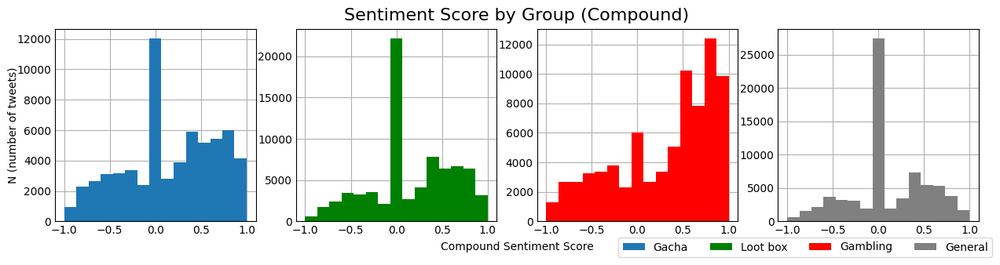

In [109]:
#Above graphs in matplotlib
def createHistPerGroup(column, title, smallBins = False):
    
    bins = [-1, -0.866, -0.733, -0.6, -0.466, -0.333, -0.2, -0.066, 0.066, 0.2, 0.333, 0.466, 0.6, 0.733, 0.866, 1]
    if smallBins: bins = [-1, -0.4, -0.3, 0.3, 0.4, 1]
    fig, ax = plt.subplots(1,4, figsize=(12,2.5))
    
    ax[0].hist((df.loc[df["group"] == "gacha"])[column], label="Gacha", bins = bins)
    ax[1].hist((df.loc[df["group"] == "lootbox"])[column], label="Loot box", color="green", bins = bins)
    ax[2].hist((df.loc[df["group"] == "gambling"])[column], label="Gambling", color="red", bins = bins)
    ax[3].hist((df.loc[df["group"] == "general"])[column], label="General", color="gray", bins = bins)
    

    fig.legend(loc="lower right", ncols=4, bbox_to_anchor=(1.01, -0.2))
    fig.suptitle(title, y = 1.1, fontsize=16)
    fig.supxlabel("Compound Sentiment Score", x = 0.5, y = -0.15, fontsize=10)
    fig.supylabel("N (number of tweets)", x = -0.04, fontsize=10)
    plt.show()

createHistPerGroup("compound", "Sentiment Score by Group (Compound)")

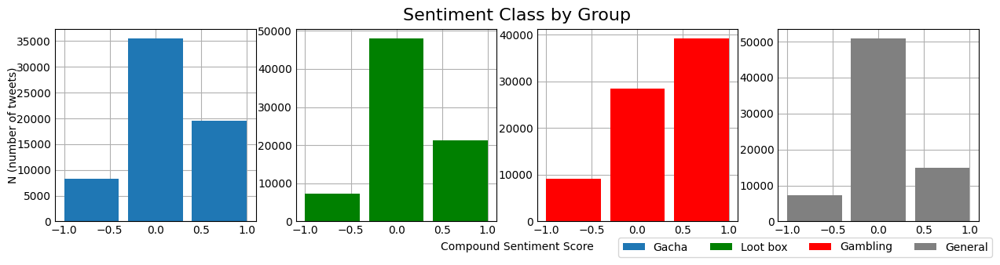

In [110]:
createHistPerGroup("sentiEnc", "Sentiment Class by Group", smallBins=True)

## Extracting Descriptive Statistics

Note that for the amount of games mentioned a number of sports were also included in the original dataset which were not considered in the final analysis.

In [12]:
def presentStatsTable(statName, statList):
    descr_df_template = pd.DataFrame({
        "Group": ["Gacha", "Lootbox", "Gambling", "General", "Total"], 
        statName: statList})
    print(descr_df_template)

def countEntries():
    result = []
    for g in ["gacha", "lootbox", "gambling", "general"]:
        tdf = df.loc[df["group"] == g]
        result.append(tdf.shape[0])
    result.append(df.shape[0])
    return result

def countEqualities(col, val):
    result = []
    for g in ["gacha", "lootbox", "gambling", "general"]:
        tdf = df.loc[df["group"] == g]
        result.append(tdf.loc[tdf[col] == val].shape[0])
    result.append(df.loc[df[col] == val].shape[0])
    return result

def avgTweetLength():
    result = []
    for g in ["gacha", "lootbox", "gambling", "general"]:
        tdf = df.loc[df["group"] == g]
        result.append(tdf["tweetLength"].mean())
    result.append(df["tweetLength"].mean())
    return result

def countProperty(col):
    result = []
    for g in ["gacha", "lootbox", "gambling", "general"]:
        tdf = df.loc[df["group"] == g]
        result.append(tdf[col].unique().shape[0])
    result.append(df[col].unique().shape[0])
    return result

def countGames(col, val):
    result = []
    for g in ["gacha", "lootbox", "gambling", "general"]:
        tdf = df.loc[df["group"] == g]
        result.append(tdf.loc[tdf[col] == val].shape[0])
    result.append(df.loc[df[col] == val].shape[0])
    return result


In [13]:
tdf = df.loc[df["group"] == "gacha"]
results = {}
for col in df.columns:
    if col not in ["Unnamed: 0", "compound", "sentiEnc", "sentiTxt", "isReply", "isRetweet", "containsMedia", "tweetLength", "userHash", "date", "Unnamed", "neg", "neu", "pos", "group"]:
        results[col] = tdf[col].sum()
        #print(f"{col}: {tdf[col].sum()}")
resultsSort = sorted(results.items(), key=lambda x:x[1])
print(resultsSort)


for i, k in enumerate(resultsSort):
    if i > 9: print(f"{k}")


[('Blackjack', 1), ('Scratch Lotteries', 1), ('Clash Royale', 4), ('Cricket', 5), ('Poker', 6), ('Craps', 7), ('Hearthstone', 9), ('Football', 9), ('Counter Strike', 12), ('Roulette', 42), ('Apex Legends', 80), ('Basketball', 274), ('Fifa', 694), ('Granblue Fantasy', 1292), ('Azur Lane', 1564), ('Honkai (Series)', 4185), ('Arknights', 4485), ('Genshin Impact', 53921)]
('Apex Legends', 80)
('Basketball', 274)
('Fifa', 694)
('Granblue Fantasy', 1292)
('Azur Lane', 1564)
('Honkai (Series)', 4185)
('Arknights', 4485)
('Genshin Impact', 53921)


In [14]:
tdf = df.loc[df["group"] == "lootbox"]
results = {}
for col in df.columns:
    if col not in ["Unnamed: 0", "compound", "sentiEnc", "sentiTxt", "isReply", "isRetweet", "containsMedia", "tweetLength", "userHash", "date", "Unnamed", "neg", "neu", "pos", "group"]:
        results[col] = tdf[col].sum()
        #print(f"{col}: {tdf[col].sum()}")
resultsSort = sorted(results.items(), key=lambda x:x[1])
print(resultsSort)


for i, k in enumerate(resultsSort):
    if i > 9: print(f"{k}")


[('Honkai (Series)', 0), ('Granblue Fantasy', 0), ('Arknights', 1), ('Azur Lane', 1), ('Blackjack', 2), ('Craps', 4), ('Scratch Lotteries', 7), ('Cricket', 19), ('Poker', 23), ('Roulette', 30), ('Genshin Impact', 44), ('Clash Royale', 132), ('Basketball', 392), ('Hearthstone', 904), ('Football', 1346), ('Counter Strike', 3231), ('Apex Legends', 9087), ('Fifa', 63313)]
('Genshin Impact', 44)
('Clash Royale', 132)
('Basketball', 392)
('Hearthstone', 904)
('Football', 1346)
('Counter Strike', 3231)
('Apex Legends', 9087)
('Fifa', 63313)


In [15]:
tdf = df.loc[df["group"] == "gambling"]
results = {}
for col in df.columns:
    if col not in ["Unnamed: 0", "compound", "sentiEnc", "sentiTxt", "isReply", "isRetweet", "containsMedia", "tweetLength", "userHash", "date", "Unnamed", "neg", "neu", "pos", "group"]:
        results[col] = tdf[col].sum()
        #print(f"{col}: {tdf[col].sum()}")
resultsSort = sorted(results.items(), key=lambda x:x[1])
print(resultsSort)


for i, k in enumerate(resultsSort):
    if i > 9: print(f"{k}")


[('Honkai (Series)', 0), ('Azur Lane', 1), ('Arknights', 2), ('Clash Royale', 2), ('Granblue Fantasy', 4), ('Hearthstone', 13), ('Apex Legends', 22), ('Genshin Impact', 58), ('Cricket', 73), ('Counter Strike', 85), ('Basketball', 403), ('Football', 432), ('Fifa', 487), ('Craps', 4070), ('Scratch Lotteries', 7296), ('Blackjack', 8765), ('Roulette', 12001), ('Poker', 46265)]
('Basketball', 403)
('Football', 432)
('Fifa', 487)
('Craps', 4070)
('Scratch Lotteries', 7296)
('Blackjack', 8765)
('Roulette', 12001)
('Poker', 46265)


In [16]:
#No of tweets
presentStatsTable("N", countProperty("userHash"))

      Group       N
0     Gacha   43832
1   Lootbox   48202
2  Gambling   56909
3   General   69300
4     Total  215132


In [17]:
#No of tweets
presentStatsTable("N", countEntries())

      Group       N
0     Gacha   63270
1   Lootbox   76569
2  Gambling   76709
3   General   72985
4     Total  289533


In [18]:
# No. of replies
presentStatsTable("N", countEqualities("isReply", 1))

      Group       N
0     Gacha   30023
1   Lootbox   55632
2  Gambling   47700
3   General   51989
4     Total  185344


In [19]:
#No. of RT's
presentStatsTable("N", countEqualities("isRetweet", 1))

      Group  N
0     Gacha  0
1   Lootbox  0
2  Gambling  0
3   General  0
4     Total  0


In [20]:
presentStatsTable("N", countEqualities("containsMedia", 1))

      Group  N
0     Gacha  0
1   Lootbox  0
2  Gambling  1
3   General  0
4     Total  1


In [21]:
presentStatsTable("N", avgTweetLength())

      Group           N
0     Gacha  149.771756
1   Lootbox  118.354216
2  Gambling  154.680168
3   General   68.812167
4     Total  122.355448


## Statistical Analysis
Using kruskall wallis

In [22]:
kruskal = stats.kruskal(df.loc[df["group"] == "gacha"]["sentiEnc"], 
                        df.loc[df["group"] == "lootbox"]["sentiEnc"], 
                        df.loc[df["group"] == "gambling"]["sentiEnc"], 
                        df.loc[df["group"] == "general"]["sentiEnc"])
kruskal

KruskalResult(statistic=10762.828240458271, pvalue=0.0)

In [23]:
dataKruskall = [df.loc[df["group"] == "gacha"]["sentiEnc"], 
                df.loc[df["group"] == "lootbox"]["sentiEnc"], 
                df.loc[df["group"] == "gambling"]["sentiEnc"], 
                df.loc[df["group"] == "general"]["sentiEnc"]]
p_values= sp.posthoc_dunn(dataKruskall, p_adjust = 'holm')
print("Post hoc analysis using Dunn's Test:") 
print(p_values)
print(p_values > 0.05) 
print("false indicates that two groups are statistically significant or that the null hypothesis is rejected. IE they have a different median")

Post hoc analysis using Dunn's Test:
               1              2    3              4
1   1.000000e+00   1.017895e-01  0.0  5.077189e-146
2   1.017895e-01   1.000000e+00  0.0  1.217163e-141
3   0.000000e+00   0.000000e+00  1.0   0.000000e+00
4  5.077189e-146  1.217163e-141  0.0   1.000000e+00
       1      2      3      4
1   True   True  False  False
2   True   True  False  False
3  False  False   True  False
4  False  False  False   True
false indicates that two groups are statistically significant or that the null hypothesis is rejected. IE they have a different median


In [24]:
def effectSizeEta2(H, k, n):
    return (H - k + 1)/(n - k)

print("Calculating effect size:")

H = kruskal[0]
k = 4
n = df.shape[0]
# eta2 = (H - k + 1)/(n - k); 
print(effectSizeEta2(H, k, n))

print("effect size:", kruskal[0]/(n - 1)) # simplify formulae

Calculating effect size:
0.03716321418738113
effect size: 0.03717319066789948
